In [ ]:
!pip install ultralytics opencv-python matplotlib albumentations pandas --quiet
print("✅ Dependencies installed")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 20.4 MB/s eta 0:00:00
✅ Dependencies installed


In [ ]:
import os

# Create dataset folders
folders = [
    "dataset/train/images",
    "dataset/train/labels",
    "dataset/val/images",
    "dataset/val/labels"
]

for f in folders:
    os.makedirs(f, exist_ok=True)

print("✅ Folders created")


✅ Folders created


In [ ]:
from google.colab import files

print("Upload your dataset zip or individual images/labels here:")
uploaded = files.upload()


Upload your dataset zip or individual images/labels here:


Saving bird vs drone.v1i.yolov8.zip to bird vs drone.v1i.yolov8.zip


In [ ]:
import zipfile
import os
from ultralytics import YOLO

zip_path = 'bird vs drone.v1i.yolov8.zip'
extract_path = '/content/dataset'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("✅")

yaml_path = os.path.join(extract_path, 'data.yaml')

with open(yaml_path, 'r') as f:
    lines = f.readlines()

with open(yaml_path, 'w') as f:
    for line in lines:
        if line.startswith('train:'):
            f.write(f'train: {extract_path}/train/images\n')
        elif line.startswith('val:'):
            f.write(f'val: {extract_path}/valid/images\n')
        elif line.startswith('test:'):
            f.write(f'test: {extract_path}/test/images\n')
        else:
            f.write(line)

print("✅ YAML")

model = YOLO('yolov8s.pt')

model.train(
    data=yaml_path,
    epochs=50,
    imgsz=640,
    batch=16,
    name='Adham_Final_Project'
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅
✅ YAML
Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.9.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=64

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b34855ed040>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [ ]:
from google.colab import files
files.download('/content/runs/detect/Adham_Final_Project/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


image 1/56 /content/dataset/valid/images/0000000006_jpg.rf.981de7dd90a0e0a742d608836a8e270f.jpg: 640x640 (no detections), 16.3ms
image 2/56 /content/dataset/valid/images/0000000016_jpg.rf.c0078565d1c6a3435155869943e2e38c.jpg: 640x640 (no detections), 16.2ms
image 3/56 /content/dataset/valid/images/0000000024_jpg.rf.d56a0d231084d73d34e28e13e527da8d.jpg: 640x640 (no detections), 16.2ms
image 4/56 /content/dataset/valid/images/0000000039_jpg.rf.cd7c4a9e03cad92226f970007ee2528f.jpg: 640x640 1 bird, 16.3ms
image 5/56 /content/dataset/valid/images/0000000048_jpg.rf.d3b537e5c9ee6795bcf58e610769f839.jpg: 640x640 1 bird, 16.3ms
image 6/56 /content/dataset/valid/images/0000000060_jpg.rf.a831dbb6ae498702d88f387498a1c822.jpg: 640x640 12 birds, 16.2ms
image 7/56 /content/dataset/valid/images/0000000075_jpg.rf.e78b0c72cf7d21cf4284ad9488942bb7.jpg: 640x640 7 birds, 16.3ms
image 8/56 /content/dataset/valid/images/0000000076_jpg.rf.7ac0932a8a0d41a8194dbae0e1620669.jpg: 640x640 3 birds, 16.2ms
image 9/

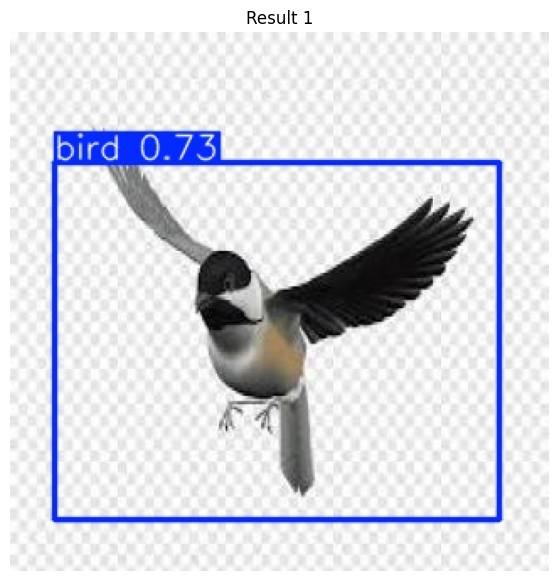

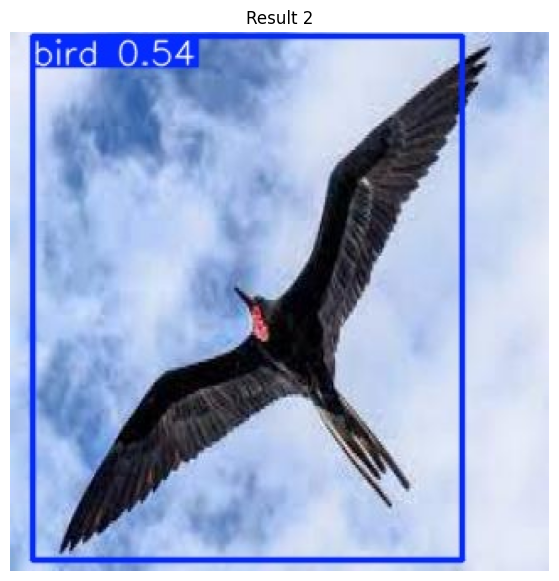

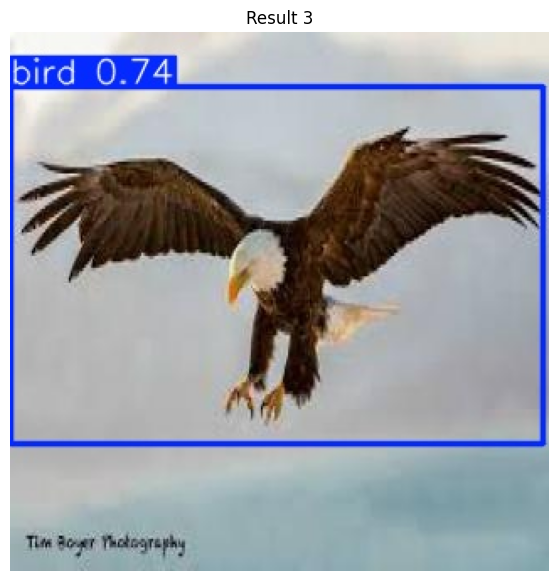

In [ ]:
from ultralytics import YOLO
import glob
import matplotlib.pyplot as plt
import cv2

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

results = model.predict(source='/content/dataset/valid/images', save=True, conf=0.5)

predicted_files = glob.glob('/content/runs/detect/predict/*.jpg')
for i in range(min(3, len(predicted_files))):
    img = cv2.imread(predicted_files[i])
    plt.figure(figsize=(10, 7))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"Result {i+1}")
    plt.show()


image 1/34 /content/dataset/test/images/0000000008_jpg.rf.9c470f475e2e6838a6ae15390b51de58.jpg: 640x640 2 birds, 16.2ms
image 2/34 /content/dataset/test/images/0000000009_jpg.rf.41422f4f203c69442e26ab953ca3aa6c.jpg: 640x640 1 bird, 16.2ms
image 3/34 /content/dataset/test/images/0000000010_jpg.rf.e96a21c2b286688c4337738882d0bf58.jpg: 640x640 7 birds, 16.2ms
image 4/34 /content/dataset/test/images/0000000029_jpg.rf.e3bd33074df8a7e5864706a7fef8231f.jpg: 640x640 1 bird, 16.2ms
image 5/34 /content/dataset/test/images/0000000043_jpg.rf.2c3e1cdd70c8cbeeba96f8953004da4a.jpg: 640x640 2 birds, 1 drone, 15.3ms
image 6/34 /content/dataset/test/images/0000000045_jpg.rf.2235fa229815262f02e8c5e295d1c90d.jpg: 640x640 6 birds, 14.1ms
image 7/34 /content/dataset/test/images/0000000046_jpg.rf.dd95a06cbf548c75980882a5cb2d66bd.jpg: 640x640 7 birds, 14.1ms
image 8/34 /content/dataset/test/images/0000000058_jpg.rf.df095a6a4f4c8918eab2ffeb82b2a1fe.jpg: 640x640 1 drone, 14.1ms
image 9/34 /content/dataset/test

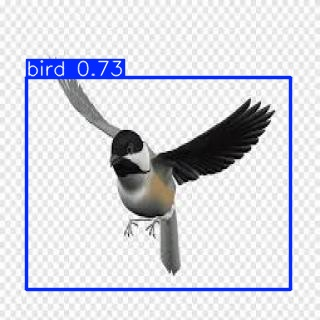

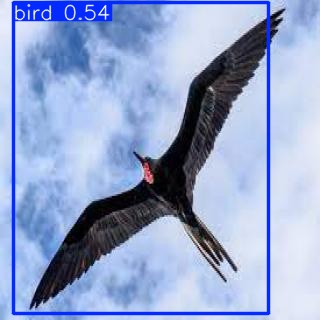

In [ ]:
# ارفع فيديو عندك وسميه test_video.mp4 وبعدين شغل ده
model.predict(source='test_video.mp4', save=True, conf=0.4)

# الفيديو الجديد هتلاقيه في فولدر runs/detect/predict2

In [ ]:
import os
import glob
from ultralytics import YOLO
import matplotlib.pyplot as plt

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

test_images = glob.glob('/content/dataset/test/images/*.jpg')
if len(test_images) == 0:
    test_images = glob.glob('/content/dataset/valid/images/*.jpg')

target_image = test_images[0]
results = model.predict(source=target_image, visualize=True, save=True, conf=0.25)

print(f"✅ : {target_image}")
print("📁 : runs/detect/predict/visualize")


Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage0_Conv_features.png... (32/32)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage1_Conv_features.png... (32/64)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage2_C2f_features.png... (32/64)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage3_Conv_features.png... (32/128)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage4_C2f_features.png... (32/128)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage5_Conv_features.png... (32/256)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage6_C2f_features.png... (32/256)
Saving /content/runs/detect/predict2/0000000070_jpg.rf.c317472da1cd7795693e3d31a93f5292/stage7_Conv_features.png... (32/512)
Savin

🔄 ] 1621 

🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁


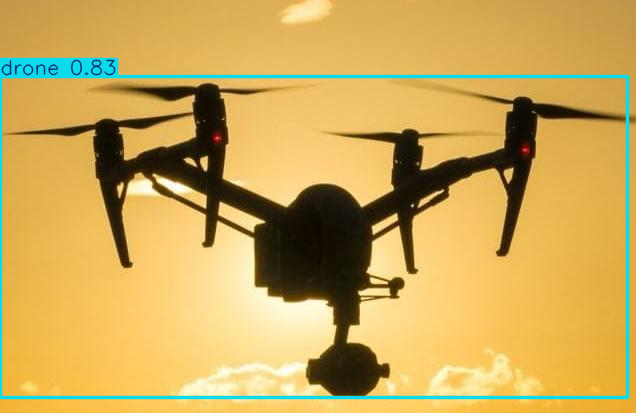

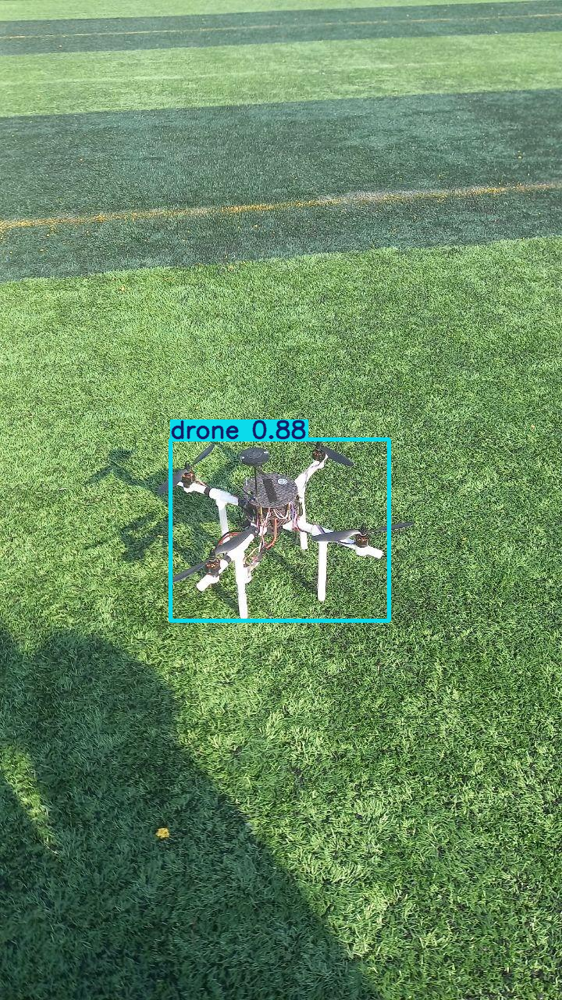

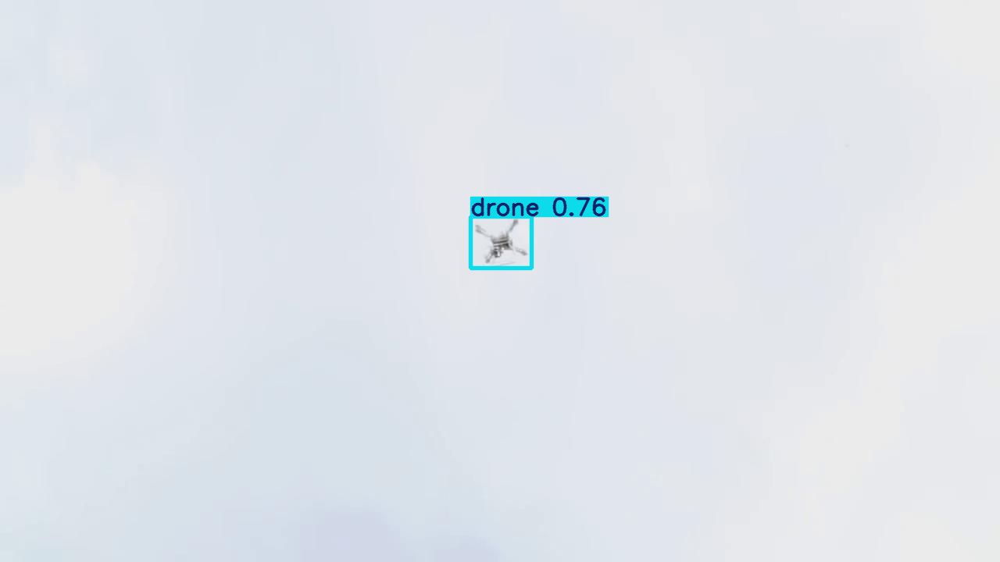

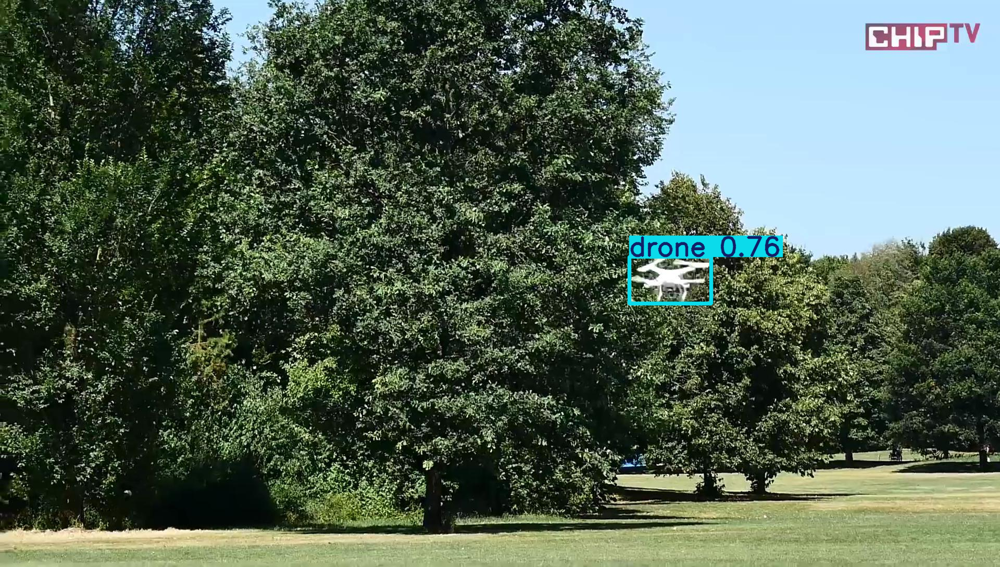

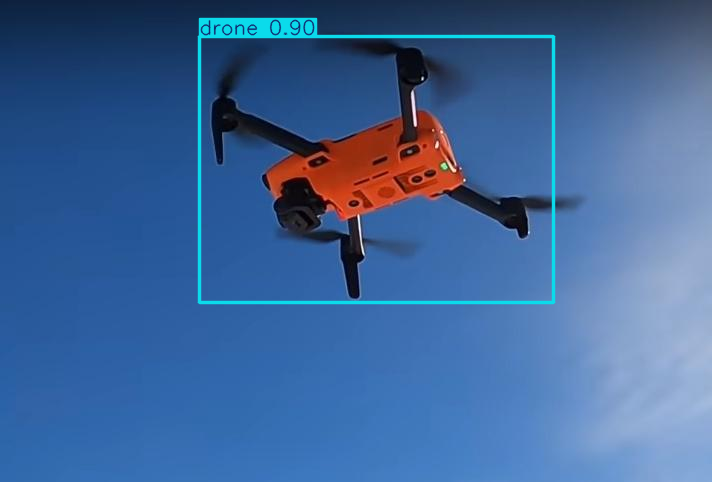


🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅


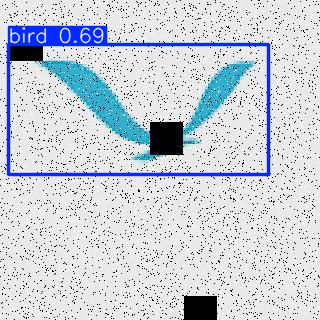

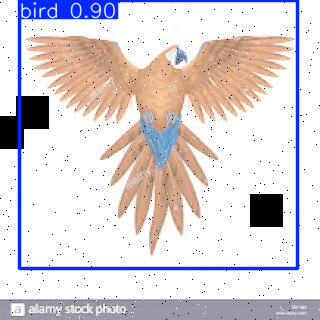

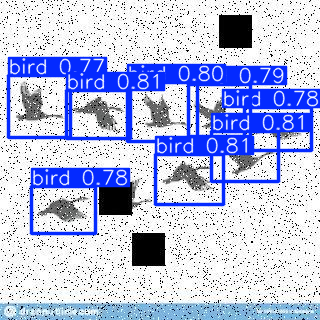

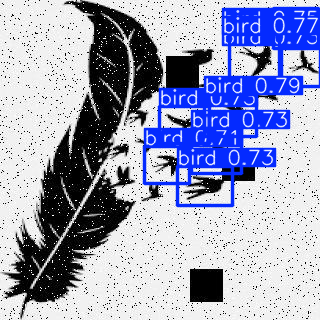

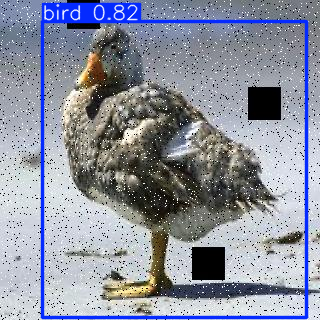

In [ ]:
import glob
import cv2
import random
from google.colab.patches import cv2_imshow
from ultralytics import YOLO

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

all_images = glob.glob('/content/dataset/**/*.jpg', recursive=True)
random.shuffle(all_images)
drone_list = []
bird_list = []

print(f"🔄 ] {len(all_images)} ")

for img_path in all_images:
    results = model.predict(source=img_path, conf=0.65, verbose=False)

    for r in results:
        if len(r.boxes) > 0:
            cls_id = int(r.boxes[0].cls[0])
            cls_name = model.names[cls_id].lower()

            if cls_name == 'drone' and len(drone_list) < 5:
                drone_list.append(r)
            elif cls_name == 'bird' and len(bird_list) < 5:
                bird_list.append(r)

    if len(drone_list) >= 5 and len(bird_list) >= 5:
        break

print("\n" + "🚁" * 10 + "🚁" * 10)
for res in drone_list:
    cv2_imshow(res.plot())

print("\n" + "🦅" * 10 + "🦅" * 10)
for res in bird_list:
    cv2_imshow(res.plot())

In [ ]:
import gradio as gr
import cv2
from ultralytics import YOLO
import numpy as np
import os

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

def predict_image(image_input):
    if image_input is None:
        return None, "الرجاء رفع صورة."

    input_path = "temp_input.jpg"
    image_bgr = cv2.cvtColor(image_input, cv2.COLOR_RGB2BGR)
    cv2.imwrite(input_path, image_bgr)

    results = model.predict(source=input_path, conf=0.20, save=False)

    annotated_img = image_input.copy()
    detections = []

    for r in results:
        if len(r.boxes) > 0:
            for box in r.boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                conf = round(box.conf[0].item(), 2)
                cls = int(box.cls[0].item())
                label = model.names[cls]

                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (0, 255, 0), 3)
                text = f"{label} {conf:.2f}"
                cv2.putText(annotated_img, text, (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 3)
                detections.append(f"✅ Found: {label} ({int(conf*100)}%)")
        else:
            detections.append("❌.")

    if os.path.exists(input_path):
        os.remove(input_path)

    return annotated_img, "\n".join(detections)

iface = gr.Interface(
    fn=predict_image,
    inputs=gr.Image(type="numpy", label="Upload"),
    outputs=[
        gr.Image(type="numpy", label="Results"),
        gr.Textbox(label="Details")
    ],
    title="🚀 Adham Drone vs Bird Detector",
    description="Uplaod",
    theme="soft"
)

iface.launch(share=True)

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://c8be72ede2292ee8cf.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


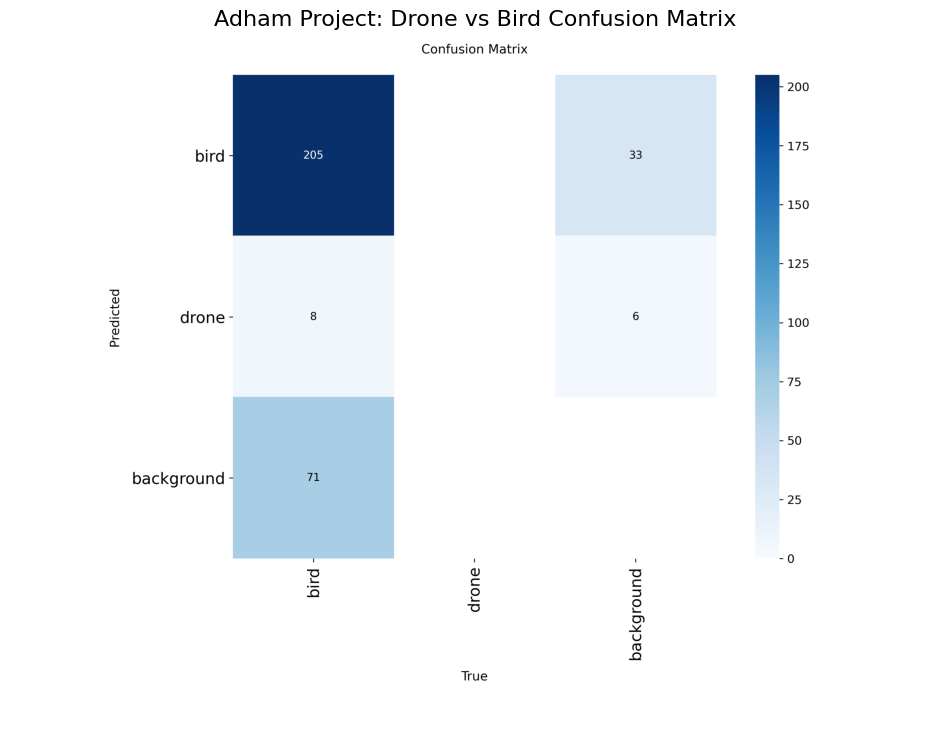

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

path = '/content/runs/detect/Adham_Final_Project/confusion_matrix.png'

try:
    img = mpimg.imread(path)
    plt.figure(figsize=(12, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title('Adham Project: Drone vs Bird Confusion Matrix', fontsize=16)
    plt.show()
except:
    print("❌")

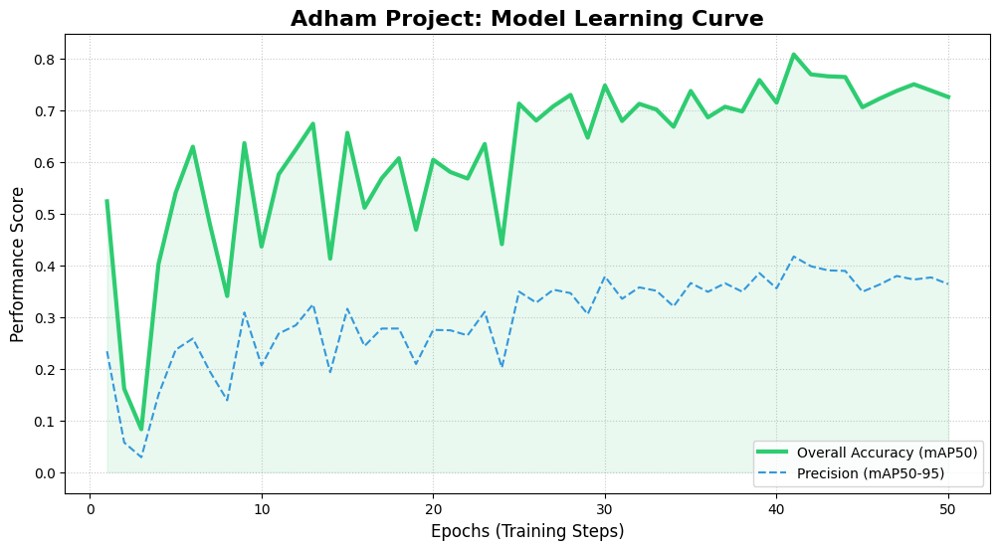

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

results_path = '/content/runs/detect/Adham_Final_Project/results.csv'

if os.path.exists(results_path):
    df = pd.read_csv(results_path)
    df.columns = [c.strip() for c in df.columns]

    plt.figure(figsize=(12, 6))

    plt.plot(df['epoch'], df['metrics/mAP50(B)'], label='Overall Accuracy (mAP50)', color='#2ecc71', linewidth=3)

    plt.plot(df['epoch'], df['metrics/mAP50-95(B)'], label='Precision (mAP50-95)', color='#3498db', linestyle='--')

    plt.title('Adham Project: Model Learning Curve', fontsize=16, fontweight='bold')
    plt.xlabel('Epochs (Training Steps)', fontsize=12)
    plt.ylabel('Performance Score', fontsize=12)
    plt.legend(loc='lower right')
    plt.grid(True, linestyle=':', alpha=0.7)

    plt.fill_between(df['epoch'], df['metrics/mAP50(B)'], color='#2ecc71', alpha=0.1)

    plt.show()

🔍

🚁🚁🚁🚁🚁🚁🚁🚁🚁🚁


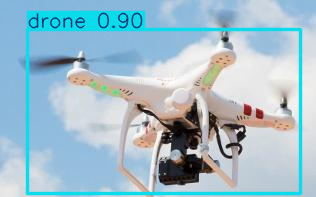

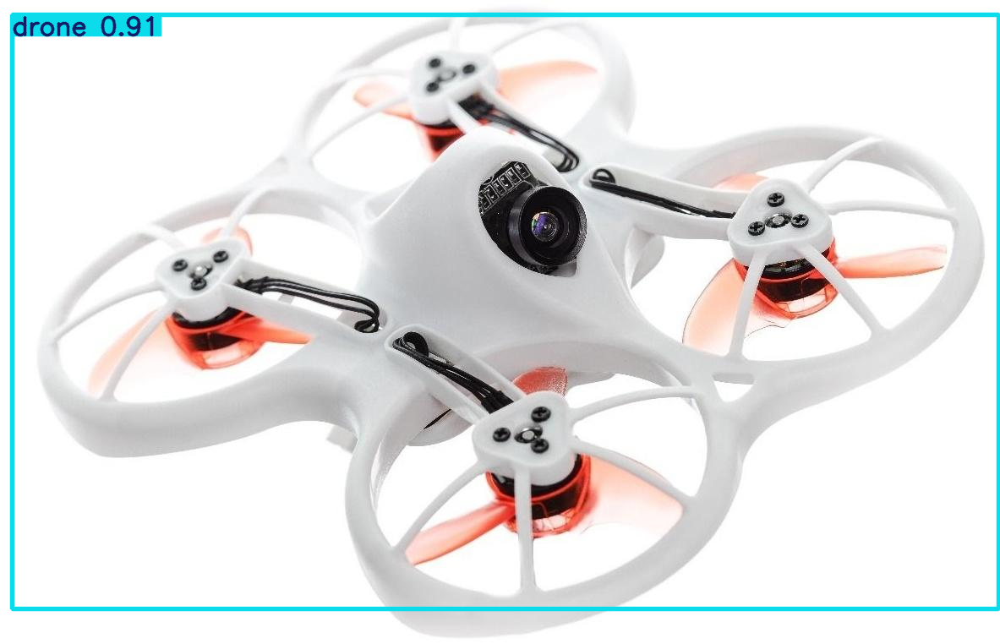

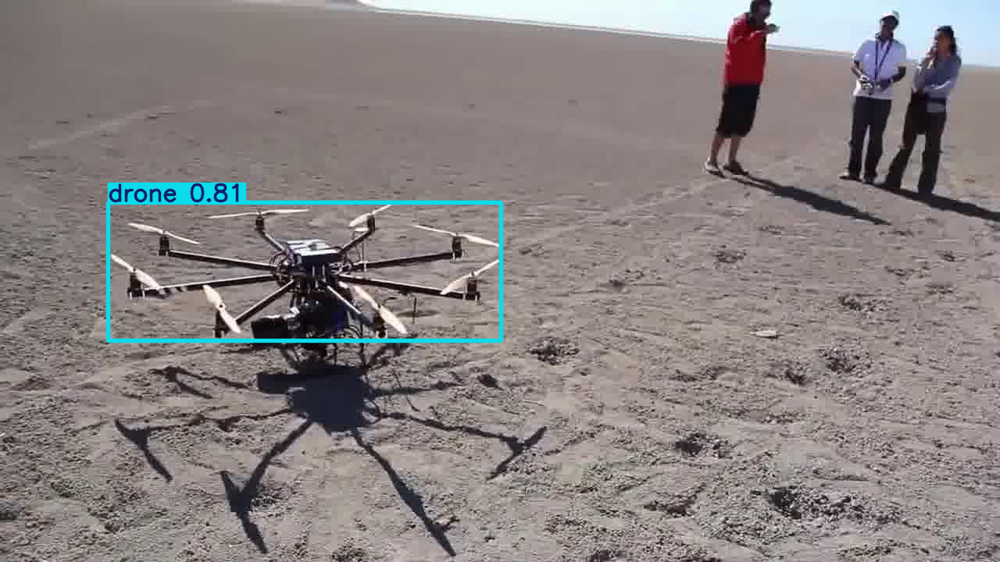

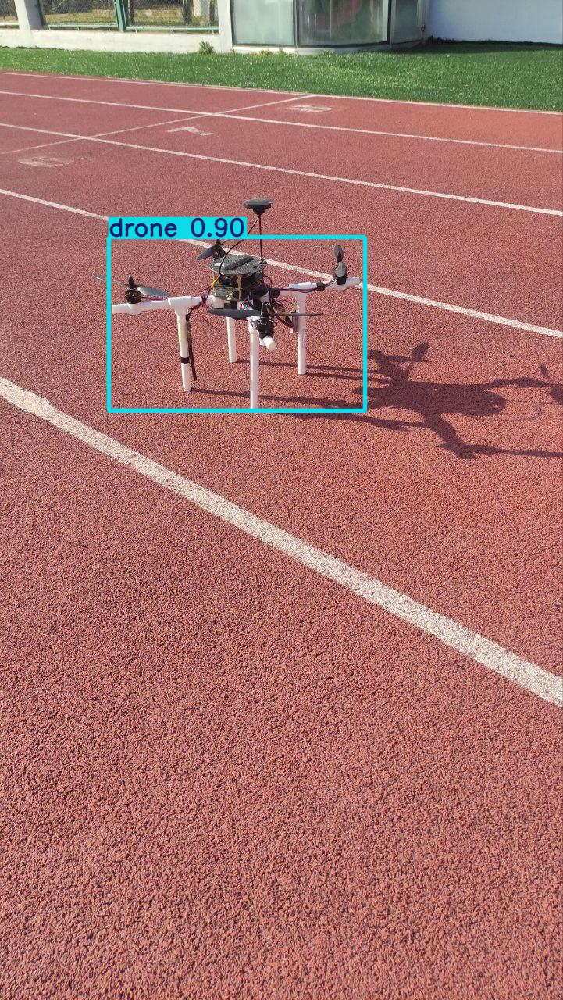

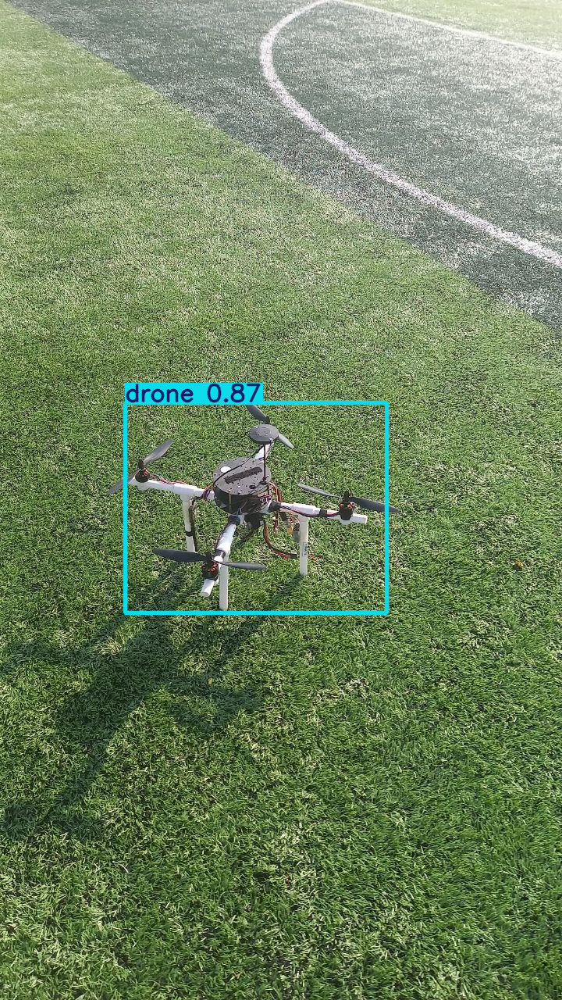


🦅🦅🦅🦅🦅🦅🦅🦅🦅🦅


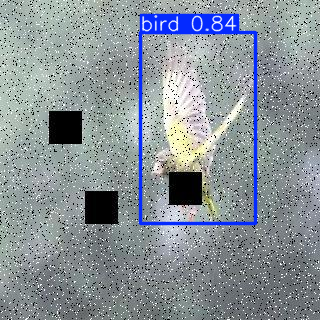

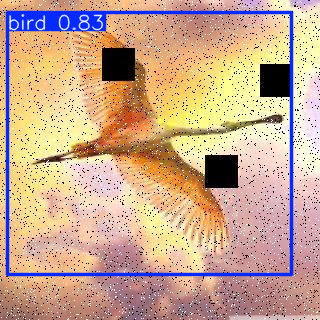

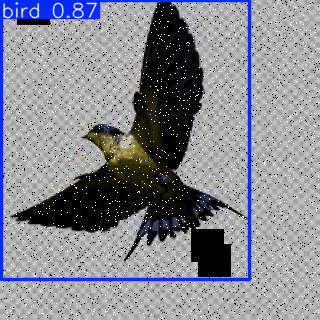

In [ ]:
import glob
import cv2
import random
from google.colab.patches import cv2_imshow
from ultralytics import YOLO

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

all_images = glob.glob('/content/dataset/**/*.jpg', recursive=True)
random.shuffle(all_images)

drone_results = []
bird_results = []

print("🔍")

for img_path in all_images:
    results = model.predict(source=img_path, conf=0.80, verbose=False)

    for r in results:
        if len(r.boxes) > 0:
            cls_id = int(r.boxes[0].cls[0])
            cls_name = model.names[cls_id].lower()

            if cls_name == 'drone' and len(drone_results) < 5:
                drone_results.append(r)

            elif cls_name == 'bird' and len(bird_results) < 3:
                bird_results.append(r)

    if len(drone_results) >= 5 and len(bird_results) >= 3:
        break

print("\n" + "🚁" * 5 + "🚁" * 5)
for res in drone_results:
    cv2_imshow(res.plot())

print("\n" + "🦅" * 5 + "🦅" * 5)
for res in bird_results:
    cv2_imshow(res.plot())

📊 100...


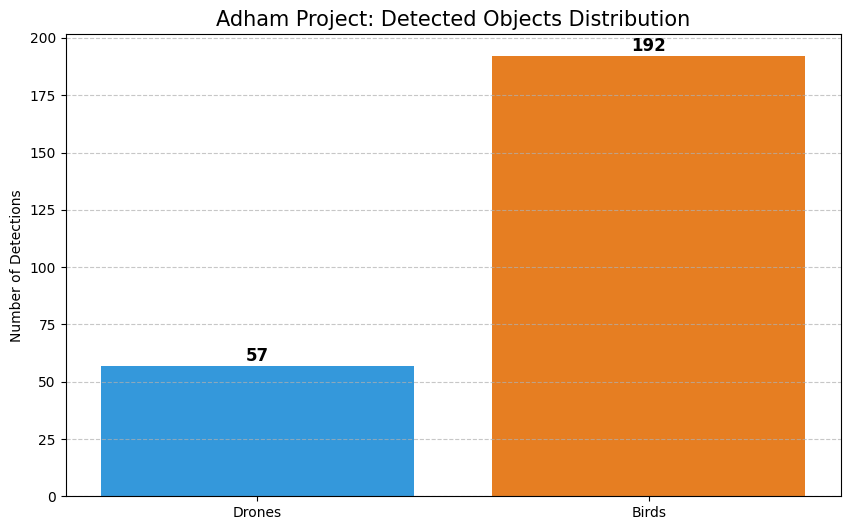

✅ 57 192 .


In [ ]:
import glob
import matplotlib.pyplot as plt
from ultralytics import YOLO

model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

all_images = glob.glob('/content/dataset/**/*.jpg', recursive=True)
sample_images = all_images[:100]

drone_count = 0
bird_count = 0

print(f"📊 {len(sample_images)}...")

for img_path in sample_images:
    results = model.predict(source=img_path, conf=0.5, verbose=False)
    for r in results:
        for box in r.boxes:
            cls_name = model.names[int(box.cls[0])].lower()
            if cls_name == 'drone':
                drone_count += 1
            elif cls_name == 'bird':
                bird_count += 1

labels = ['Drones', 'Birds']
counts = [drone_count, bird_count]
colors = ['#3498db', '#e67e22']

plt.figure(figsize=(10, 6))
bars = plt.bar(labels, counts, color=colors)

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, yval, ha='center', va='bottom', fontsize=12, fontweight='bold')

plt.title('Adham Project: Detected Objects Distribution', fontsize=15)
plt.ylabel('Number of Detections')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

print(f"✅ {drone_count} {bird_count} .")

In [ ]:
with open('app.py', 'w') as f:
    f.write('''
import streamlit as st
from ultralytics import YOLO
from PIL import Image
import os

st.set_page_config(page_title="Aerial Object Detection", layout="wide")

st.markdown("<h1 style='text-align: center;'>🚁 Aerial Object Detection System</h1>", unsafe_allow_html=True)
st.markdown("<h4 style='text-align: center;'>Drone vs. Bird Classification</h4>", unsafe_allow_html=True)
st.divider()

MODEL_PATH = '/content/runs/detect/Adham_Final_Project/weights/best.pt'

@st.cache_resource
def load_yolo_model(path):
    return YOLO(path)

if os.path.exists(MODEL_PATH):
    model = load_yolo_model(MODEL_PATH)

    col1, col2 = st.columns([1, 1])

    with col1:
        st.subheader("Input Stream")
        uploaded_file = st.file_uploader("Choose an aerial image...", type=["jpg", "jpeg", "png"])

    if uploaded_file is not None:
        image = Image.open(uploaded_file)
        with col1:
            st.image(image, caption='Source Image', use_container_width=True)

        with col2:
            st.subheader("Inference Result")
            if st.button('Execute Detection'):
                results = model.predict(image, conf=0.25)
                res_plotted = results[0].plot()
                st.image(res_plotted, caption='Detection Output', use_container_width=True)

                boxes = results[0].boxes
                if len(boxes) > 0:
                    st.success(f"Detected {len(boxes)} objects.")
                else:
                    st.warning("No objects detected in current frame.")
else:
    st.error("Engine Error: Weights file (best.pt) not found.")
''')

In [ ]:
import ipywidgets as widgets
from IPython.display import display, clear_output
from ultralytics import YOLO
from PIL import Image
import io

MODEL_PATH = '/content/runs/detect/Adham_Final_Project/weights/best.pt'
model = YOLO(MODEL_PATH)

header = widgets.HTML("<h2>🚁 Aerial Object Detection System</h2>")
sub_header = widgets.HTML("<h4>Drone vs Bird Classification</h4>")
upload = widgets.FileUpload(accept='.jpg,.png,.jpeg', multiple=False)
button = widgets.Button(description="Execute Detection", button_style='success', layout=widgets.Layout(width='200px'))
output = widgets.Output()

def on_click(b):
    with output:
        clear_output()
        if not upload.value:
            print("Please upload an image first!")
            return

        input_file = list(upload.value.values())[0]
        content = input_file['content']
        img = Image.open(io.BytesIO(content))

        print("Processing...")
        results = model.predict(img, conf=0.25)

        res_plotted = results[0].plot()
        res_img = Image.fromarray(res_plotted)
        display(res_img)

        count = len(results[0].boxes)
        print(f"✅ Detection Complete: {count} objects found.")

button.on_click(on_click)

ui = widgets.VBox([header, sub_header, widgets.Label("Upload Image:"), upload, button, output])
display(ui)

In [ ]:
!pip install gradio --quiet
import gradio as gr
from ultralytics import YOLO
from PIL import Image

# تحميل الموديل
model = YOLO('/content/runs/detect/Adham_Final_Project/weights/best.pt')

def detect_objects(img):
    results = model.predict(img, conf=0.25)
    # رسم النتيجة على الصورة
    res_plotted = results[0].plot()
    return Image.fromarray(res_plotted)

demo = gr.Interface(
    fn=detect_objects,
    inputs=gr.Image(type="pil", label="Upload Aerial Image"),
    outputs=gr.Image(type="pil", label="Detection Result"),
    title="🚁 Aerial Object Detection System",
    description="Adham's Final Project: Detect Drones and Birds in Real-time."
)

demo.launch(share=True)

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://56cc629e3e7d7923de.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
